In [4]:
import glob
import cv2
import matplotlib.pyplot as plt
import os

def imread(img_path):
  img = cv2.imread(img_path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  return img

def display(img1, img2):
  fig = plt.figure(figsize=(25, 10))
  ax1 = fig.add_subplot(1, 2, 1)
  plt.title('Input image', fontsize=16)
  ax1.axis('off')
  ax2 = fig.add_subplot(1, 2, 2)
  plt.title('NAFNet output', fontsize=16)
  ax2.axis('off')
  ax1.imshow(img1)
  ax2.imshow(img2)

def display3(img1, img2, img3):
  fig = plt.figure(figsize=(25, 10))
  ax1 = fig.add_subplot(1, 3, 1)
  plt.title('Input image', fontsize=16)
  ax1.axis('off')
  ax2 = fig.add_subplot(1, 3, 2)
  plt.title('NAFNet output', fontsize=16)
  ax2.axis('off')
  ax3 = fig.add_subplot(1, 3, 3)
  plt.title('NAFNet output', fontsize=16)
  ax3.axis('off')
  ax1.imshow(img1)
  ax2.imshow(img2)
  ax3.imshow(img3)
  
def compare(A_folder, B_folder) : 
  for file in os.listdir(A_folder) :    
    file_name_no_ext = os.path.splitext(file)[0]
    possible_outputs = glob.glob(os.path.join(A_folder, f"{file_name_no_ext}.*"))
    if not possible_outputs:
        continue 
    input_path = possible_outputs[0]

    file_name_no_ext = file_name_no_ext 
    possible_outputs = glob.glob(os.path.join(B_folder, f"{file_name_no_ext}.*"))
    if not possible_outputs:
        continue 
    output_path = possible_outputs[0]

    img_input = imread(input_path)
    img_output = imread(output_path)
    
    display(img_input, img_output)

In [45]:
def expend3x3(input_image_path, output_image_path):
    # 讀取圖片
    image = cv2.imread(input_image_path)
    if image is None:
        raise FileNotFoundError(f"找不到 {input_image_path}")

    h, w, c = image.shape
    output = np.zeros((h * 3, w * 3, c), dtype=image.dtype)

    # 建立翻轉對照表 (i=row, j=col)
    # flip code: 0=vertical, 1=horizontal, -1=both
    flip_map = {
        (0, 0): -1, (0, 1): 0, (0, 2): -1,
        (1, 0): 1, (1, 1): None, (1, 2): 1,
        (2, 0): -1, (2, 1): 0, (2, 2): -1
    }

    # 將圖像貼到 3x3 大圖中，依據位置翻轉
    for i in range(3):
        for j in range(3):
            flip_code = flip_map[(i, j)]
            if flip_code is None:
                tile = image
            else:
                tile = cv2.flip(image, flipCode=flip_code)
            y, x = i * h, j * w
            output[y:y+h, x:x+w] = tile

    cv2.imwrite(output_image_path, output)

def expend2x2(input_image_path, output_image_path):
    # 讀取圖片
    image = cv2.imread(input_image_path)
    if image is None:
        raise FileNotFoundError(f"找不到 {input_image_path}")

    h, w, c = image.shape
    output = np.zeros((h * 3, w * 3, c), dtype=image.dtype)

    # 建立翻轉對照表 (i=row, j=col)
    # flip code: 0=vertical, 1=horizontal, -1=both
    flip_map = {
        (0, 0): -1, (0, 1): 0, (0, 2): -1,
        (1, 0): 1, (1, 1): None, (1, 2): 1,
        (2, 0): -1, (2, 1): 0, (2, 2): -1
    }

    # 將圖像貼到 3x3 大圖中，依據位置翻轉
    for i in range(3):
        for j in range(3):
            flip_code = flip_map[(i, j)]
            if flip_code is None:
                tile = image
            else:
                tile = cv2.flip(image, flipCode=flip_code)
            y, x = i * h, j * w
            output[y:y+h, x:x+w] = tile

    output = output[h//2:h+h+h//2, w//2:w+w+w//2]  # 只取中間的2x2區域
    cv2.imwrite(output_image_path, output)

def take_middle(input_image_path, output_image_path):
    image = cv2.imread(input_image_path)
    if image is None:
        raise FileNotFoundError("找不到")

    h, w, c = image.shape
    middle_h = h // 3
    middle_w = w // 3

    middle_image = image[middle_h:middle_h*2, middle_w:middle_w*2]
    cv2.imwrite(output_image_path, middle_image)

In [48]:
input_folder = "./SwinIR_expension3x3"
output_folder = "./SwinIR_expension3x3_clipped"

if not os.path.exists(output_folder):
    os.makedirs(output_folder)
    
for file in os.listdir(input_folder) :
    file_name_no_ext = os.path.splitext(file)[0]
    possible_outputs = glob.glob(os.path.join(input_folder, f"{file_name_no_ext}.*"))
    if not possible_outputs:
        continue 
    input_path = os.path.join(os.getcwd(), possible_outputs[0])
    
    output_path = os.path.join(os.getcwd(), output_folder, possible_outputs[0].split('/')[-1].split('\\')[-1])
    take_middle(input_path, output_path)

In [19]:
import cv2
import numpy as np
import os

IMAGE_PATH = "./mprnet_deblur_output/castle.png"

OUTPUT_IMAGE_PATH = "./output"
SPATIAL_FILTER_NAME = "spatial_filter.jpg"
FREQENCY_FILTER_NAME = "frequency_filter.jpg"

def change_2_gray(image):
    # print("[*] change_2_gray")
    gray_image = np.zeros((image.shape[0], image.shape[1]), dtype=np.uint8)
    
    gray_image = np.mean(image, axis=2).astype(np.uint8)
    # print("[*] complete change_2_gray")
    return gray_image

def do_spatial_filter(image, kernel) : 
    # print("[*] do_spatial_filter")
    # get kernel info
    kernel_height, kernel_width = kernel.shape
    kernel_center_x = kernel_width // 2
    kernel_center_y = kernel_height // 2
    
    # get image info
    image_height, image_width = image.shape
    image_output = np.zeros((image_height, image_width), dtype=np.uint8)
    
    # padding
    padded_size = (image_height + kernel_height - 1, image_width + kernel_width - 1)
    image_padding = np.zeros(padded_size, dtype=np.uint8)
    image_padding[kernel_center_y:kernel_center_y + image_height, 
                kernel_center_x:kernel_center_x + image_width] = image
    
    # convolution
    for i in range(image_height) : 
        for j in range(image_width) :
            target = image_padding[i:i + kernel_height, j:j + kernel_width]
            image_output[i, j] = np.clip(np.sum(target * kernel), 0, 255)
    # print("[*] complete do_spatial_filter")
    return image_output

def laplacian_filter_freq(gray_image):
    # print("[*] laplacian_filter_freq")
    f = gray_image
    F = np.fft.fft2(gray_image)
    F_shift = np.fft.fftshift(F)

    rows, cols = gray_image.shape
    center_row, center_col = rows // 2, cols // 2

    H = np.zeros((rows, cols), dtype=np.float64)
    for i in range(rows):
        for j in range(cols):
            H[i, j] = -4 * np.pi * np.pi * ((i - center_row) ** 2 + (j - center_col) ** 2)

    # Apply filter
    filtered_spectrum = F_shift * H

    # Back to spatial domain
    f_ishift = np.fft.ifftshift(filtered_spectrum)
    img_back = np.fft.ifft2(f_ishift)
    img_back = np.real(img_back)

    # Normalize the result
    img_back = (img_back - np.min(img_back)) / (np.max(img_back) - np.min(img_back)) * 512 - 256

    # print("[*] complete laplacian_filter_freq")    
    return np.clip(f - img_back, 0, 255).astype(np.uint8)

def process_image(input_image_path, output_spatial_path, output_freq_path) : 
    image = cv2.imread(input_image_path)
    if image is None :
        raise ValueError("image is None")
    
    ## convert to gray ##
    ycrcb = cv2.cvtColor(image, cv2.COLOR_BGR2YCrCb)
    y_channel, cr, cb = cv2.split(ycrcb)
    # gray_image = change_2_gray(image)
    gray_image = y_channel
    
    ## Laplasian spatial sharpening filter ##
    kernel = np.array(
                    [[0, -1, 0],
                    [-1, 5, -1],
                    [0, -1, 0]])
    spatial_filter_image = do_spatial_filter(gray_image, kernel)
    spatial_filter_image = cv2.merge([spatial_filter_image, cr, cb])
    spatial_filter_image = cv2.cvtColor(spatial_filter_image, cv2.COLOR_YCrCb2BGR)
    
    ## Laplasian frequency sharpening filter ##
    freqency_filter_image = laplacian_filter_freq(gray_image)
    freqency_filter_image = cv2.merge([freqency_filter_image, cr, cb])
    freqency_filter_image = cv2.cvtColor(freqency_filter_image, cv2.COLOR_YCrCb2BGR)

    
    cv2.imwrite(output_spatial_path, spatial_filter_image)
    cv2.imwrite(output_freq_path, freqency_filter_image)


if __name__ == "__main__" :
    folder = "./mprnet_deblur_output"
    for file in os.listdir(folder) :
        file_name_no_ext = os.path.splitext(file)[0]
        possible_outputs = glob.glob(os.path.join(folder, f"{file_name_no_ext}.*"))
        if not possible_outputs:
            continue 
        input_path = possible_outputs[0]

        image_output_path = os.path.join(os.getcwd(), "spatial_filter")
        os.makedirs(image_output_path, exist_ok=True)
        image_output_path = os.path.join(os.getcwd(), "frequency_filter")
        os.makedirs(image_output_path, exist_ok=True)
        
        spatial_path = os.path.join(os.getcwd(), "spatial_filter", os.path.basename(input_path))
        frequency_path = os.path.join(os.getcwd(), "frequency_filter", os.path.basename(input_path))
        process_image(input_path, spatial_path, frequency_path)



In [7]:
folder = "./project_denoised_noise50"

for file in os.listdir(folder):
    if file.endswith("_SwinIR.png") :
        os.rename(os.path.join(folder, file), os.path.join(folder, file.replace("_SwinIR", "")))

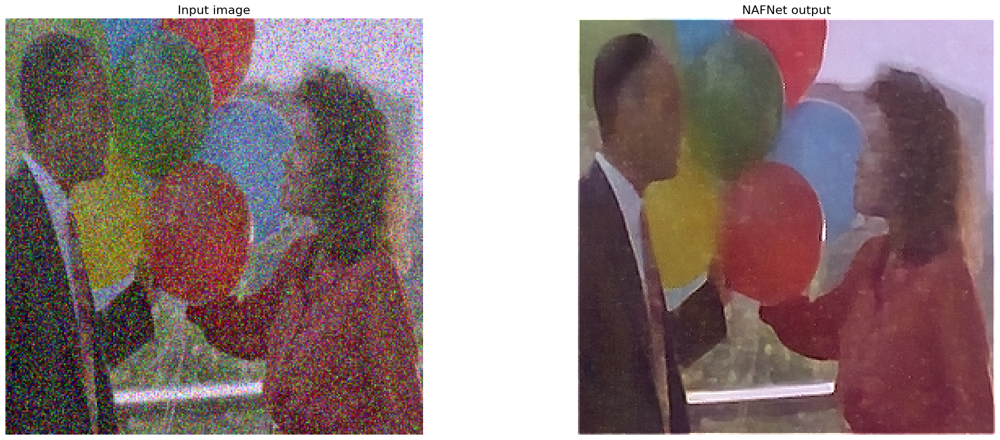

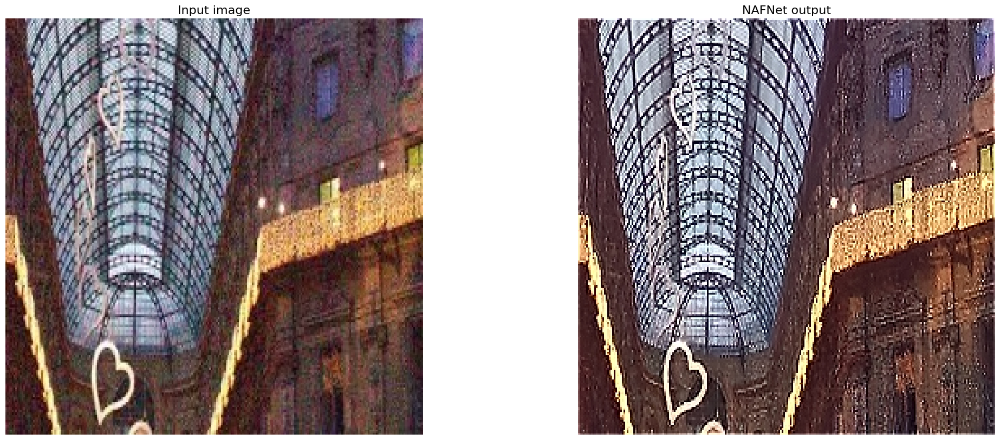

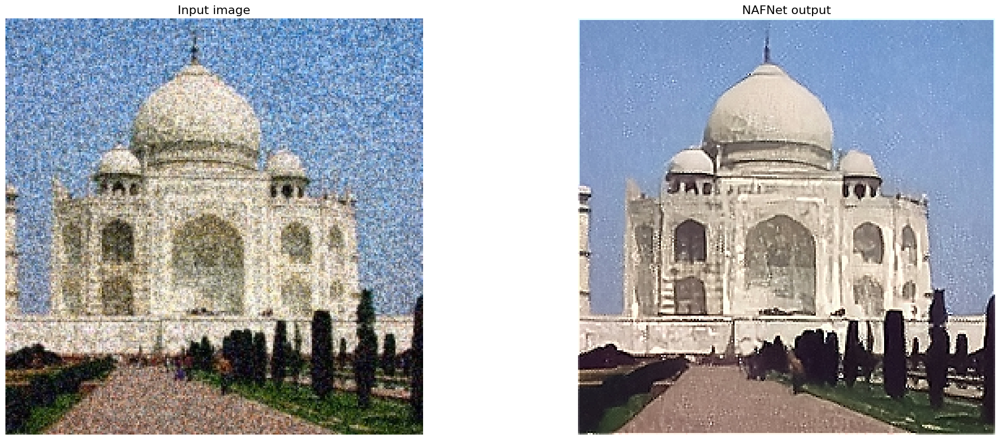

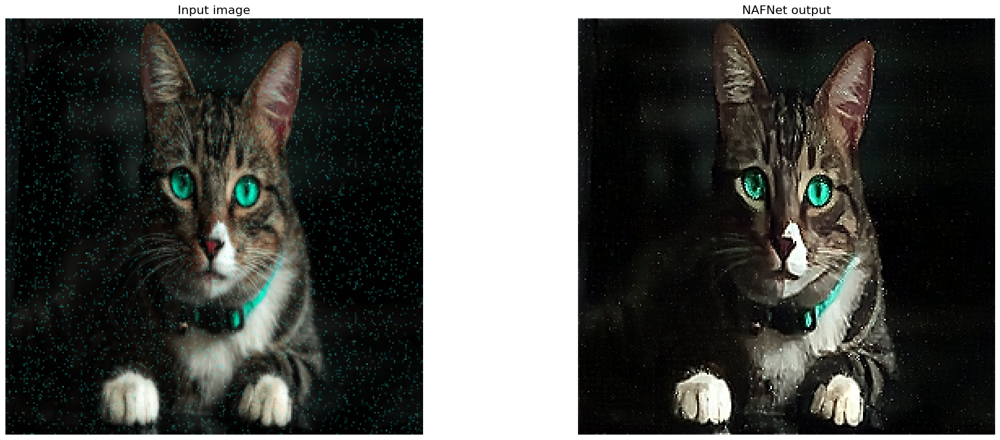

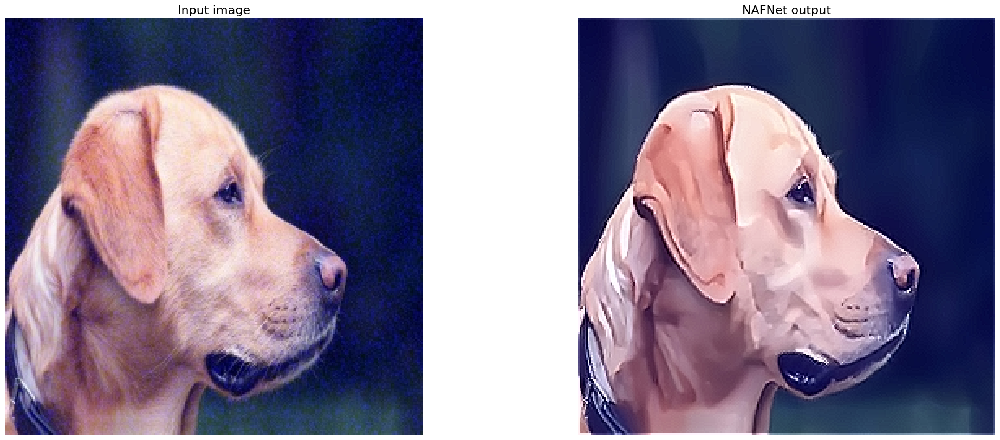

...

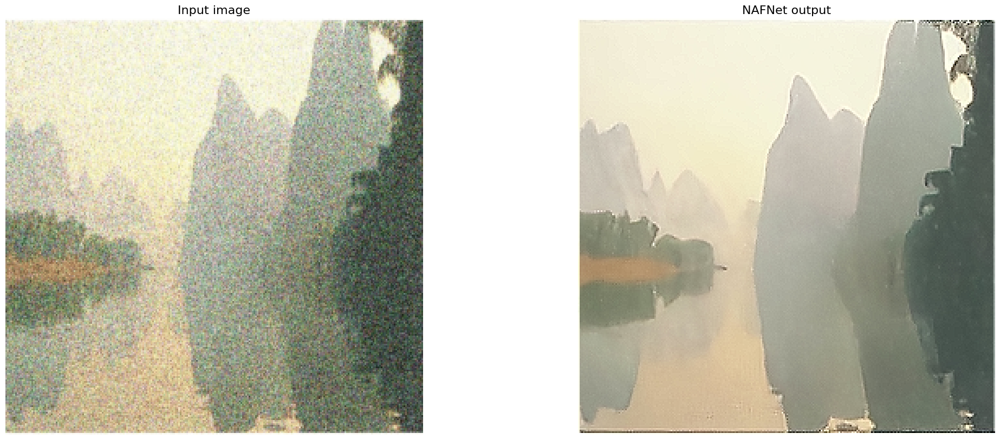

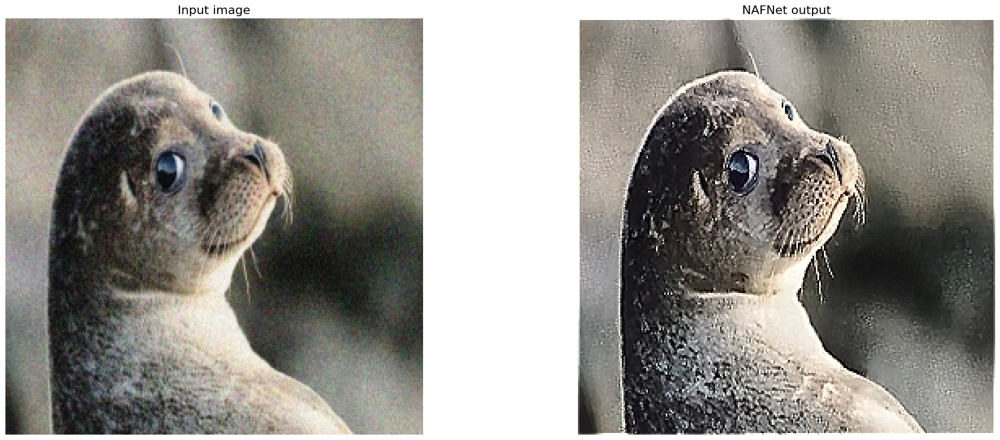

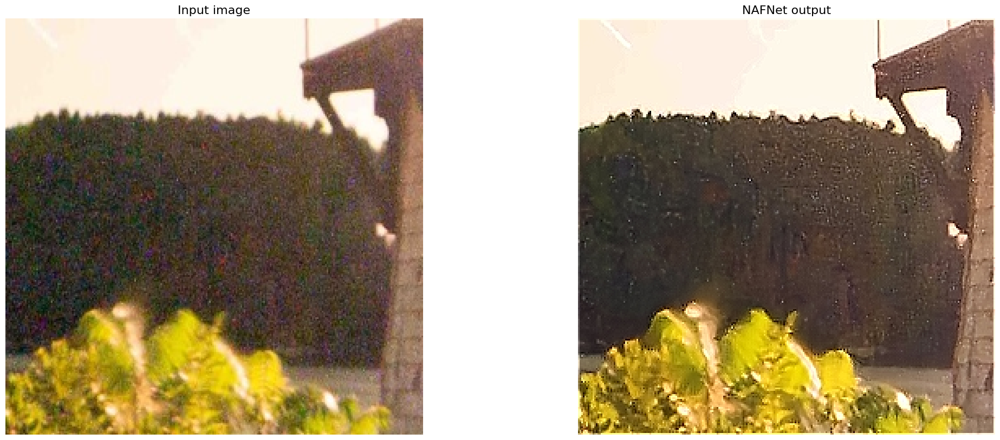

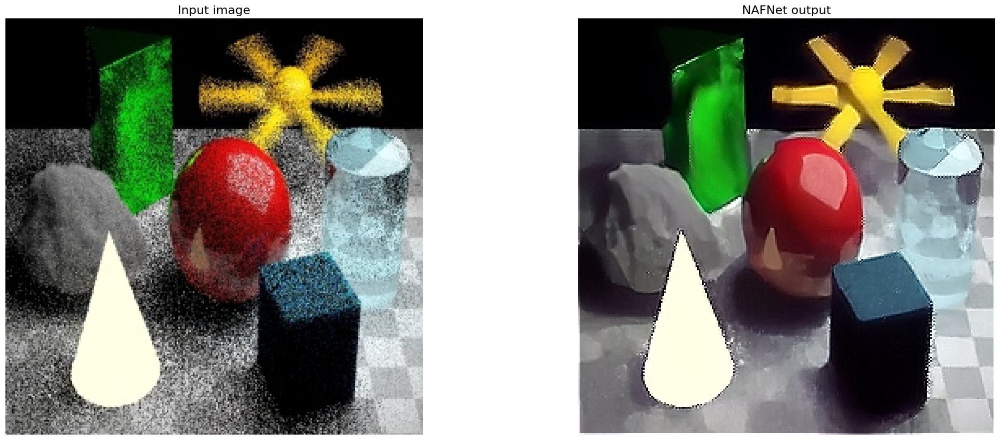

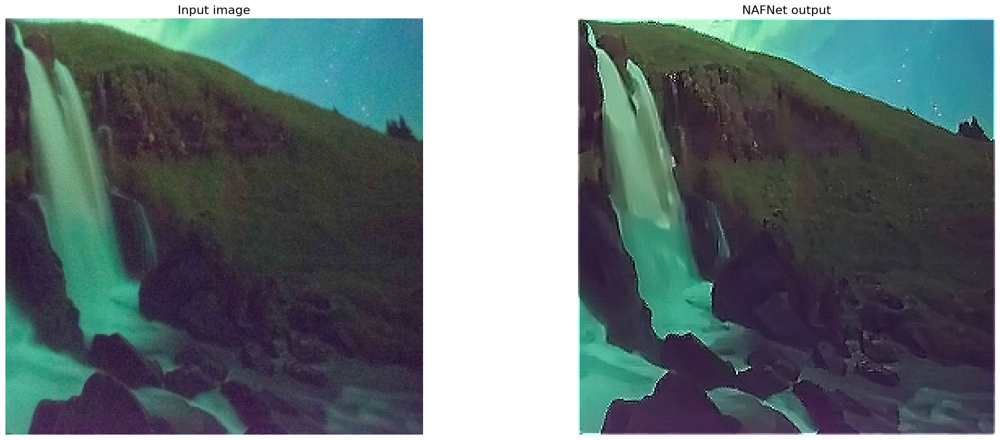

In [23]:
A="./original_images/"
B="./spatial_filter/"
# ./original_images/
# ./nafnet_denoise_images
# ./nafnet_deblur_images
# ./mprnet_denoise_output
# ./mprnet_deblur_output
# ./project_denoised_noise50
# ./spatial_filter
# ./frequency_filter
# ./SwinIR_NAFNet 


compare(A, B)

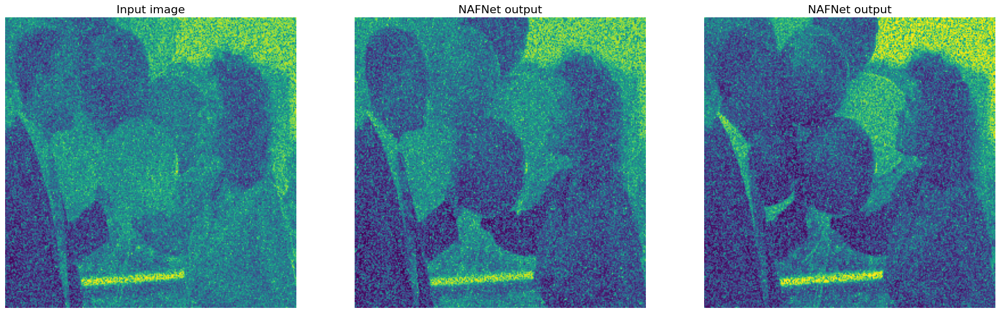

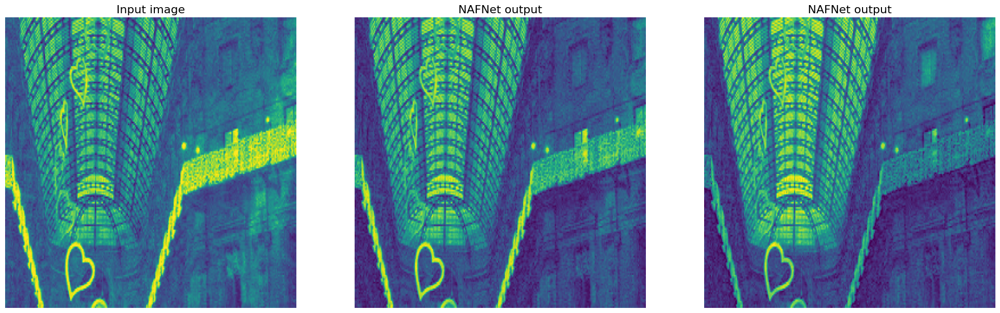

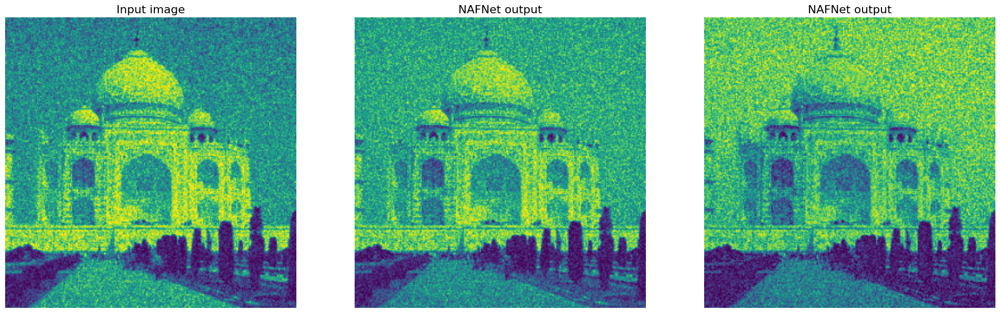

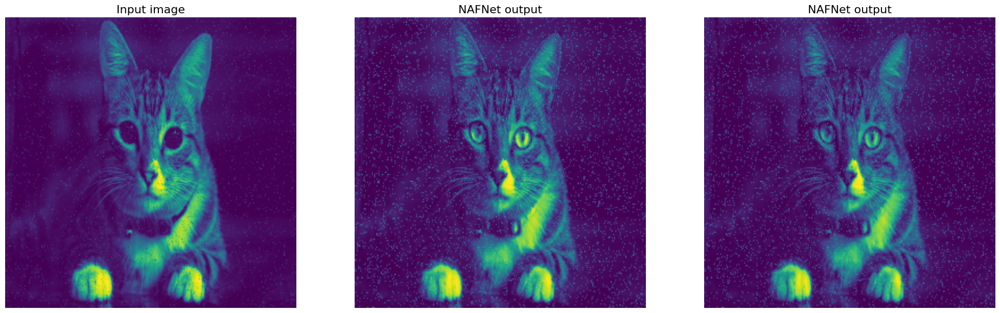

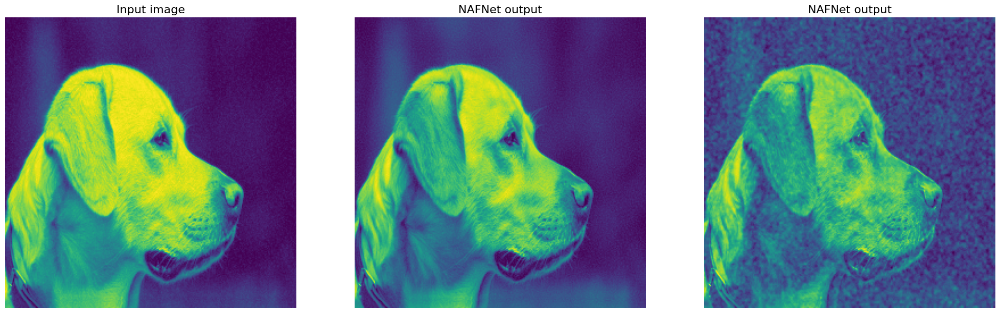

...

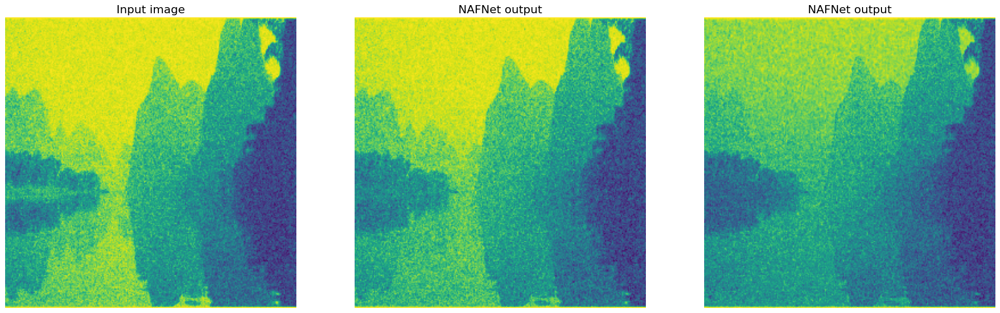

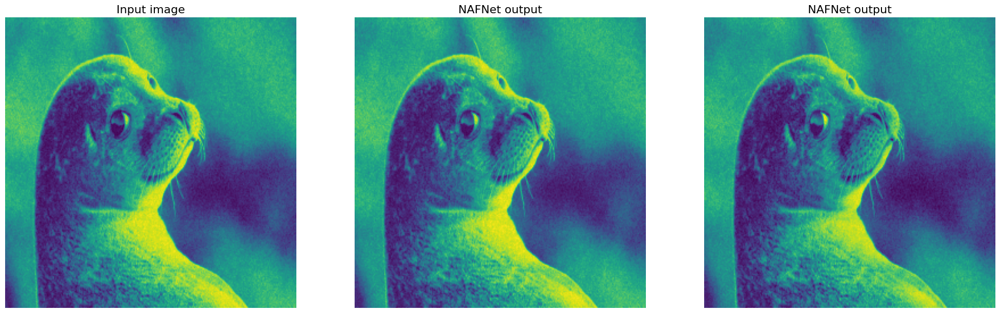

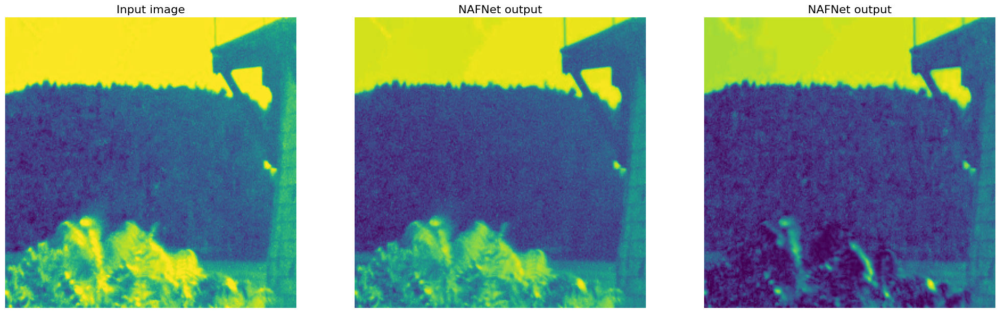

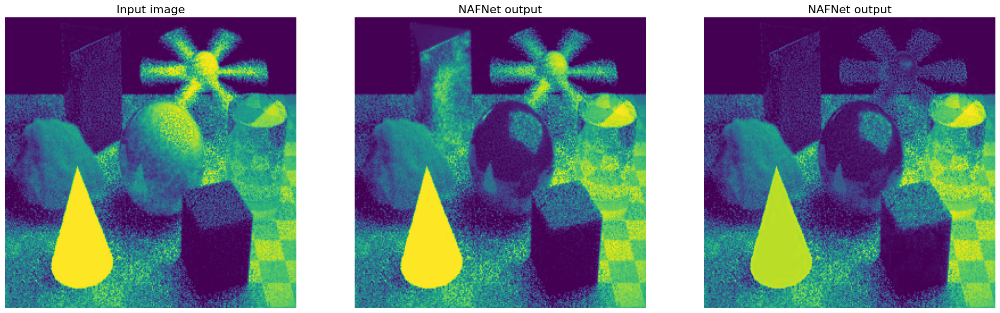

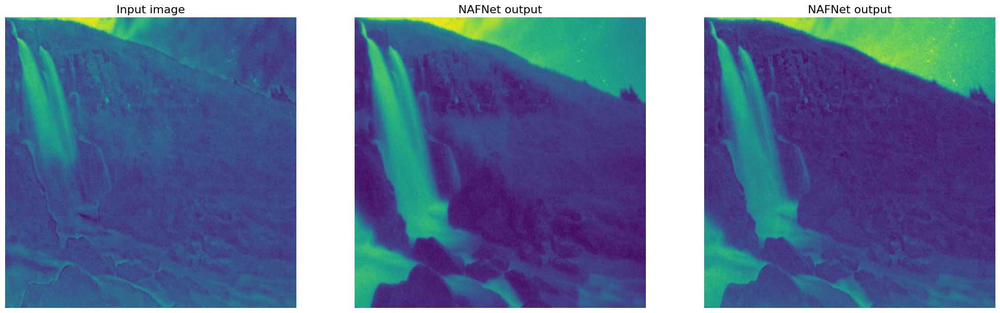

In [10]:
A_folder="./original_images/"
# B_folder="./mprnet_deblur_output/"
# ./original_images/
# ./output_deblur_images
# ./output_denoise_images
# ./mprnet_denoise_output
# ./mprnet_deblur_output
import numpy as np

def adaptive_median_filter(img, S_max=11):
    assert S_max % 2 == 1, "S_max 必須是奇數"
    padded_img = np.pad(img, S_max//2, mode='edge')
    output = np.zeros_like(img)
    rows, cols = img.shape

    for i in range(rows):
        for j in range(cols):
            S = 5  # 起始視窗大小
            while True:
                r = S // 2
                window = padded_img[i:i+S, j:j+S]
                Z_min = int(window.min())
                Z_max = int(window.max())
                Z_med = int(np.median(window))
                Z_xy  = int(img[i, j])

                A1 = Z_med - Z_min
                A2 = Z_med - Z_max

                if A1 > 0 and A2 < 0:
                    B1 = Z_xy - Z_min
                    B2 = Z_xy - Z_max
                    if B1 > 0 and B2 < 0:
                        output[i, j] = Z_xy  # 保留原值
                    else:
                        output[i, j] = Z_med  # 替換成中位數
                    break
                else:
                    S += 2  # 增加視窗大小
                    if S > S_max:
                        output[i, j] = Z_med  # 強制用中位數
                        break
                    # 更新視窗
                    window = padded_img[i + S//2 - r : i + S//2 + r + 1,
                                        j + S//2 - r : j + S//2 + r + 1]

    return output

for file in os.listdir(A_folder) :    
    # file_name_no_ext = os.path.splitext(file)[0]
    # possible_outputs = glob.glob(os.path.join(A_folder, f"{file_name_no_ext}.*"))
    # if not possible_outputs:
    #     continue 
    # input_path = possible_outputs[0]

    # possible_outputs = glob.glob(os.path.join(B_folder, f"{file_name_no_ext}.*"))
    # if not possible_outputs:
    #     continue 
    # output_path = possible_outputs[0]
    img_input = imread(os.path.join(A_folder, file))
    b, g, r = cv2.split(img_input)

    display3(b, g, r)
    # b = adaptive_median_filter(b)
    # g = adaptive_median_filter(g)
    # r = adaptive_median_filter(r)
    
    # img_output = cv2.merge((b, g, r))
    # display3(b, g, r)
    # display(img_input, img_output)
